## **Demo Notebook**

This quick notebook will show how to

* load config
* create the dataset
* make a model
* load pretrained weights

This notebook should be run directly from the `scripts/` directory.

### **Config**

Make sure to change the following paths
* `DATASET_DIR`
* `LABELS_DIR`

In [1]:
from hydra import core, initialize, compose
from omegaconf import OmegaConf


# CHANGE ME
DATASET_DIR = '../datasets/nuscenes/v1.0-trainval'
LABELS_DIR = '../datasets/cvt_labels_nuscenes'


core.global_hydra.GlobalHydra.instance().clear()        # required for Hydra in notebooks

initialize(config_path='../config')

# Add additional command line overrides
cfg = compose(
    config_name='config',
    overrides=[
        'experiment.save_dir=../logs/',                 # required for Hydra in notebooks
        '+experiment=cvt_nuscenes_vehicle',
        f'data.dataset_dir={DATASET_DIR}',
        f'data.labels_dir={LABELS_DIR}',
        'data.version=v1.0-trainval',
        'loader.batch_size=1',
    ]
)

# resolve config references
OmegaConf.resolve(cfg)

print(list(cfg.keys()))

['experiment', 'loader', 'optimizer', 'scheduler', 'trainer', 'model', 'data', 'visualization', 'loss', 'metrics']


/tmp/ipykernel_1060476/3436959509.py:12: UserWarning: 
The version_base parameter is not specified.
Please specify a compatability version level, or None.
Will assume defaults for version 1.1
  initialize(config_path='../config')


### **Dataset Setup**

In [2]:
import torch
import numpy as np

from cross_view_transformer.common import setup_experiment, load_backbone


# Additional splits can be added to cross_view_transformer/data/splits/nuscenes/
SPLIT = 'val_qualitative_000'
SUBSAMPLE = 5


model, data, viz = setup_experiment(cfg)

dataset = data.get_split(SPLIT, loader=False)
dataset = torch.utils.data.ConcatDataset(dataset)
#dataset = torch.utils.data.Subset(dataset, range(0, len(dataset), SUBSAMPLE))
dataset = torch.utils.data.Subset(dataset, range(0, 5)) # get first 5 sample

loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=False, num_workers=2)

print(len(dataset))

Loaded pretrained weights for efficientnet-b4
5


### **Network Setup**

In [3]:
from pathlib import Path


# # Download a pretrained model (13 Mb)
# MODEL_URL = 'https://www.cs.utexas.edu/~bzhou/cvt/cvt_nuscenes_vehicles_50k.ckpt'
CHECKPOINT_PATH = '../logs/cvt_nuscenes_vehicles_50k.ckpt'

# !wget $MODEL_URL -O $CHECKPOINT_PATH


if Path(CHECKPOINT_PATH).exists():
    network = load_backbone(CHECKPOINT_PATH)
else:
    network = model.backbone

    print(f'{CHECKPOINT_PATH} not found. Using randomly initialized weights.')

Loaded pretrained weights for efficientnet-b4


### **Run the Model**

This cell will save the model predictions and render them as a gif.

Note: colors will be ugly since gif only supports 256 colors total

['cam_idx', 'image', 'intrinsics', 'extrinsics', 'bev', 'view', 'visibility', 'center', 'pose']
(6, 14, 30)


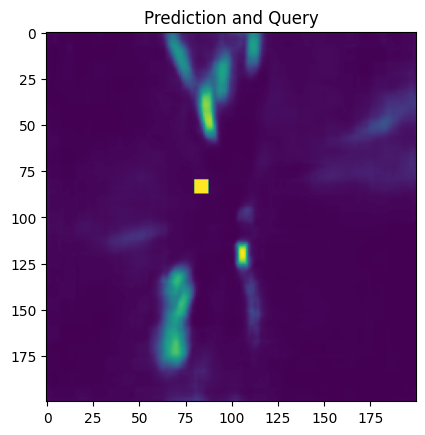

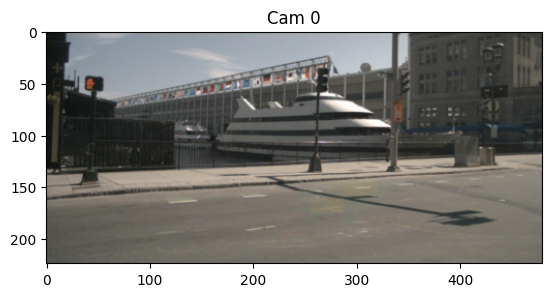

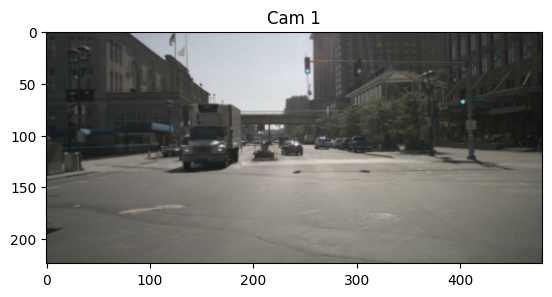

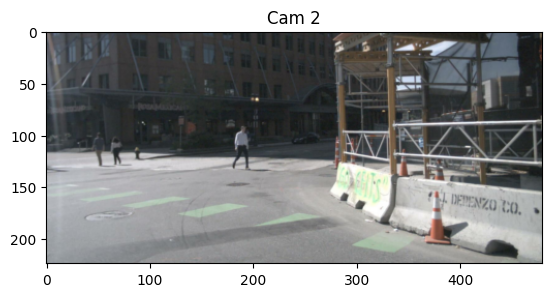

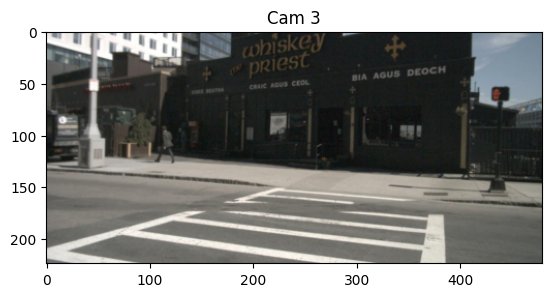

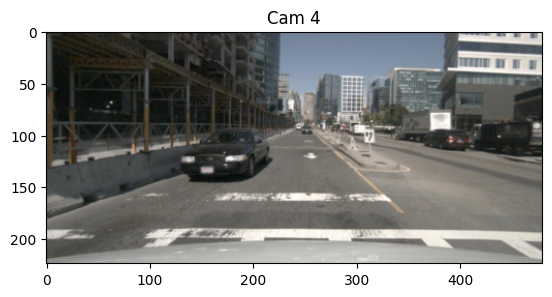

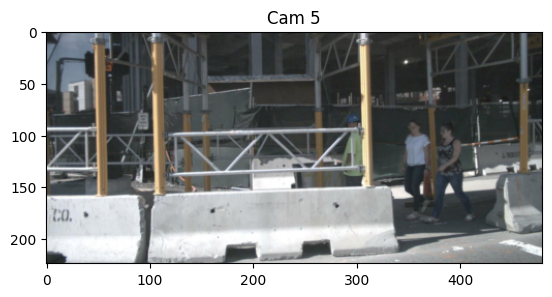

(6, 14, 30)


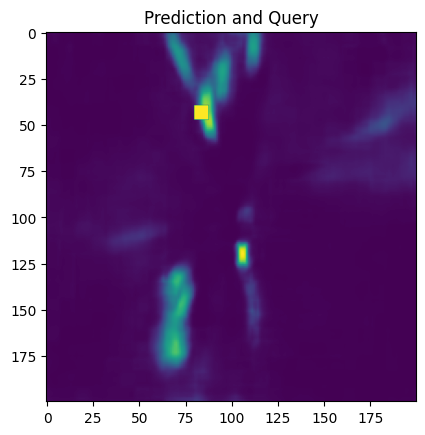

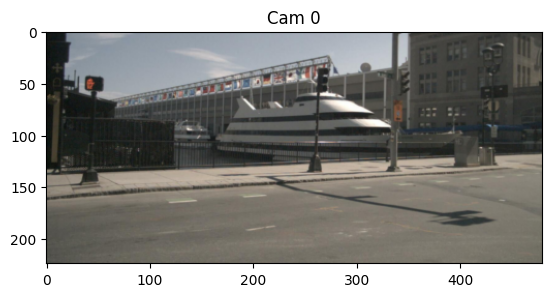

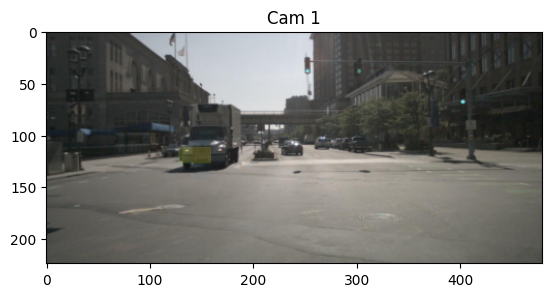

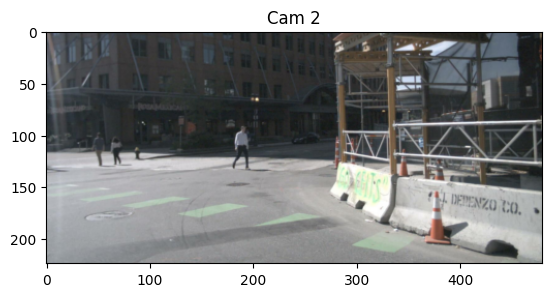

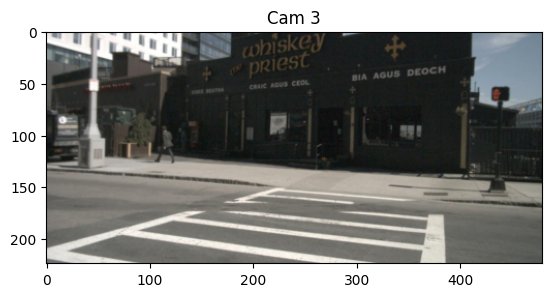

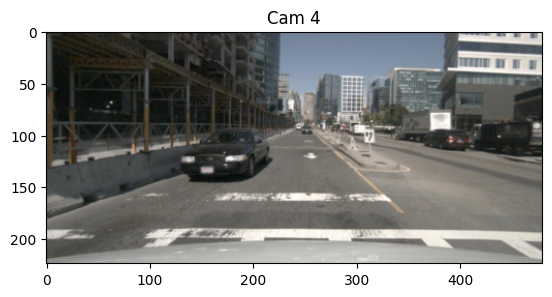

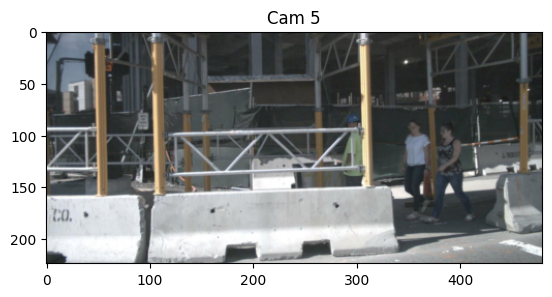

(6, 14, 30)


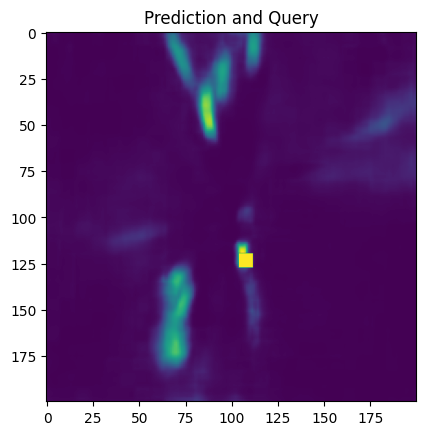

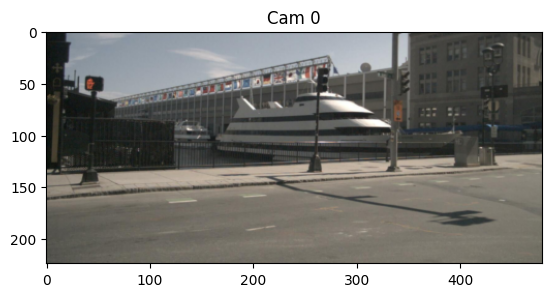

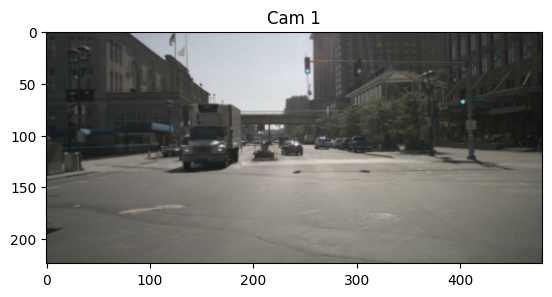

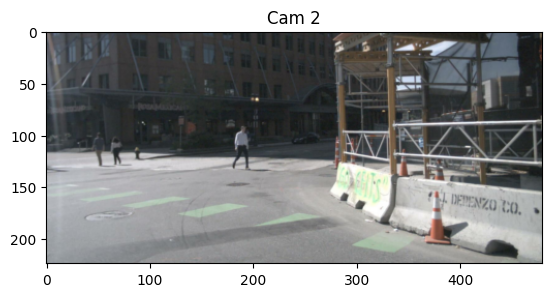

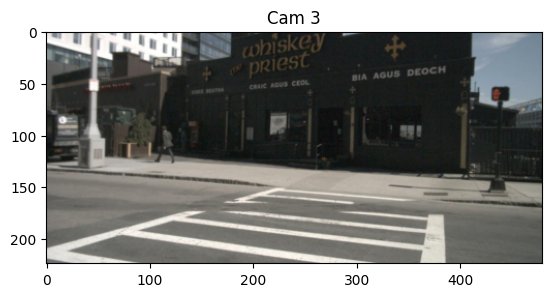

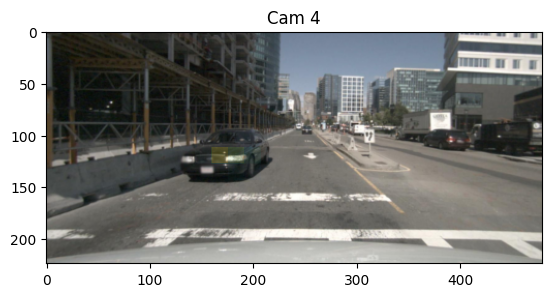

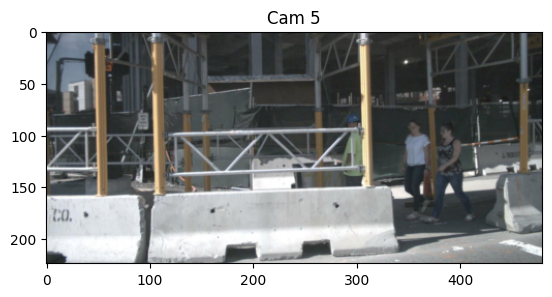

['cam_idx', 'image', 'intrinsics', 'extrinsics', 'bev', 'view', 'visibility', 'center', 'pose']
(6, 14, 30)


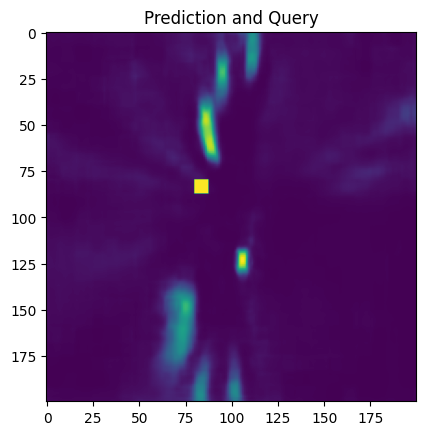

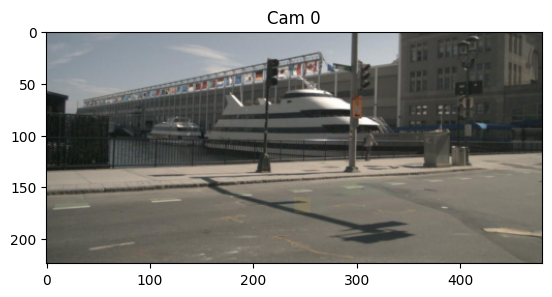

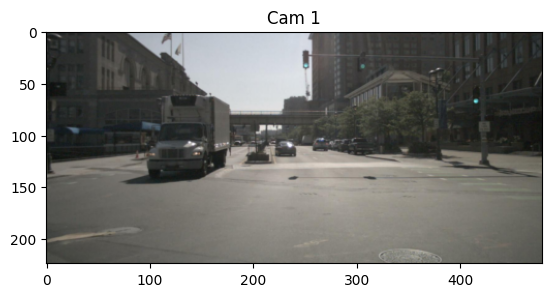

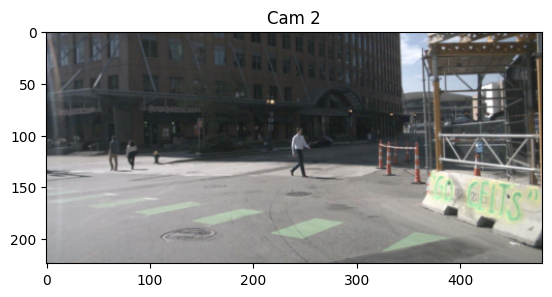

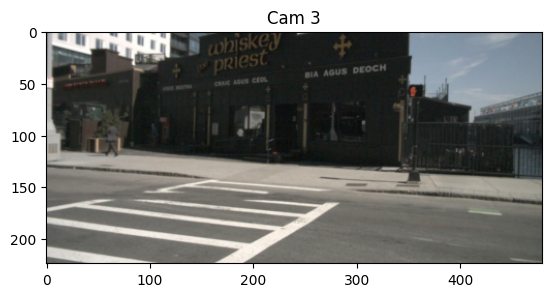

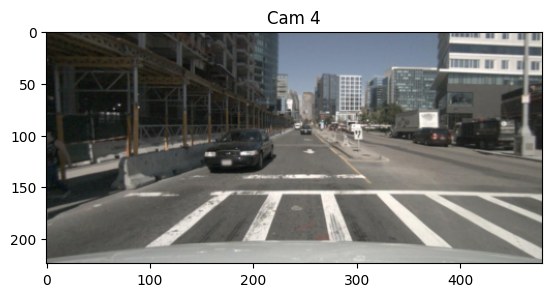

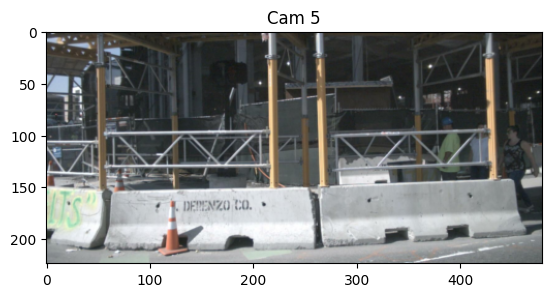

(6, 14, 30)


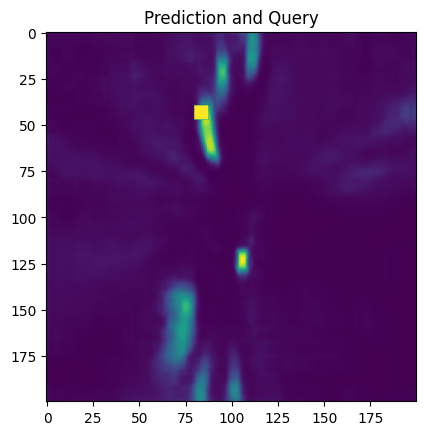

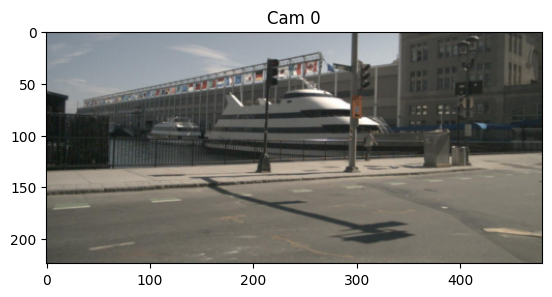

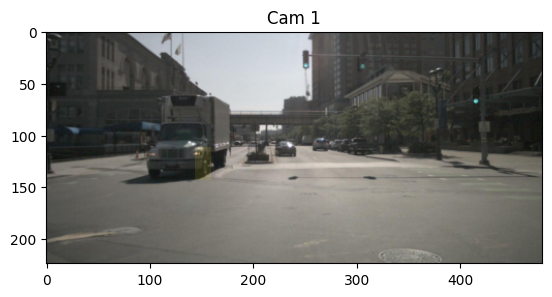

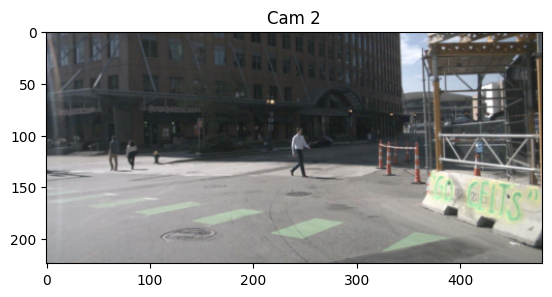

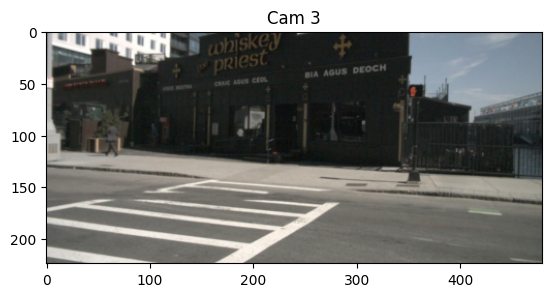

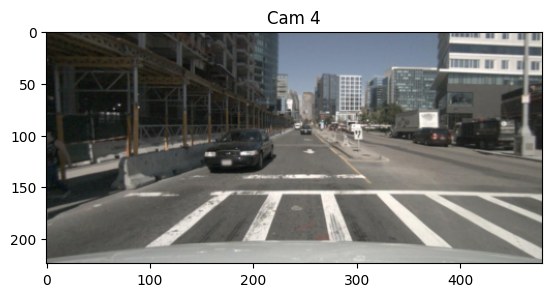

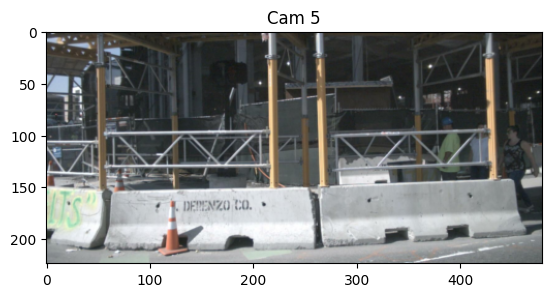

(6, 14, 30)


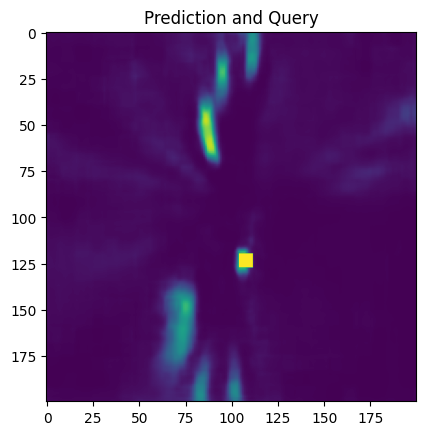

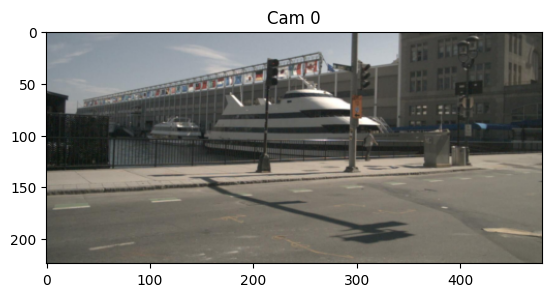

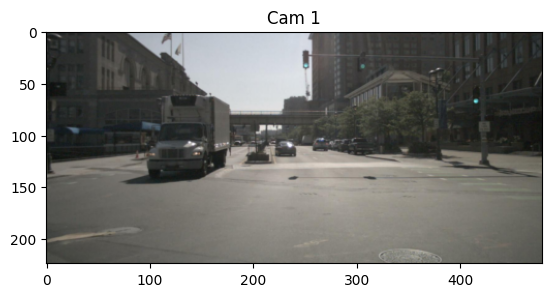

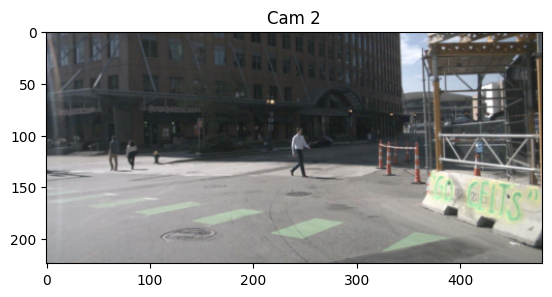

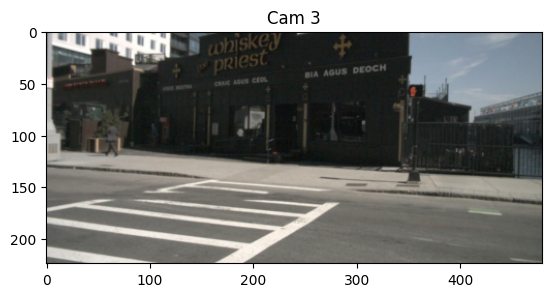

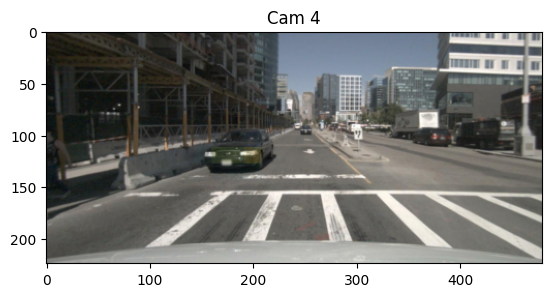

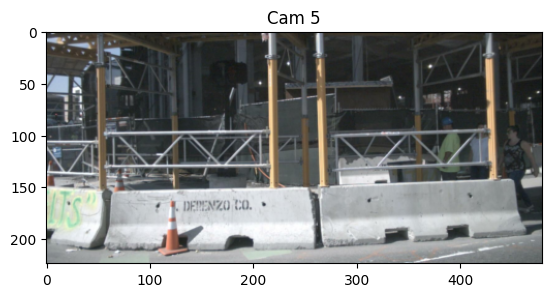

['cam_idx', 'image', 'intrinsics', 'extrinsics', 'bev', 'view', 'visibility', 'center', 'pose']
(6, 14, 30)


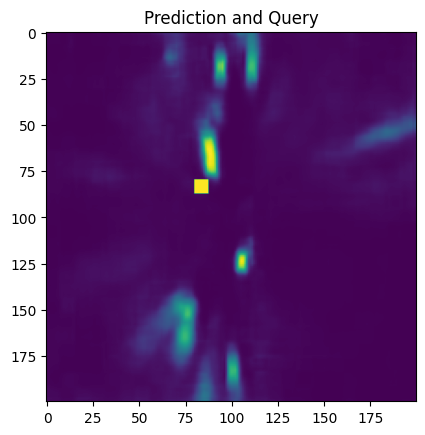

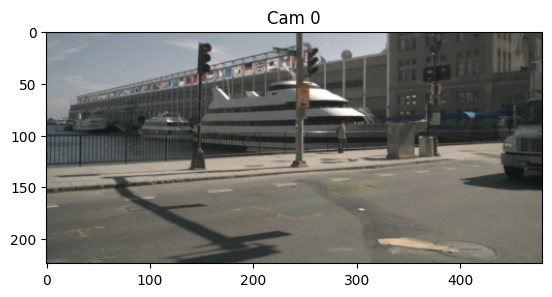

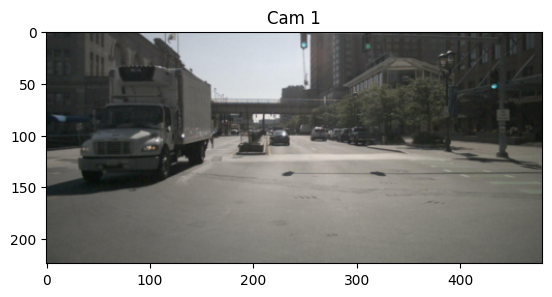

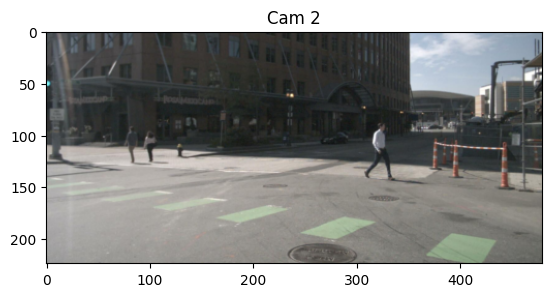

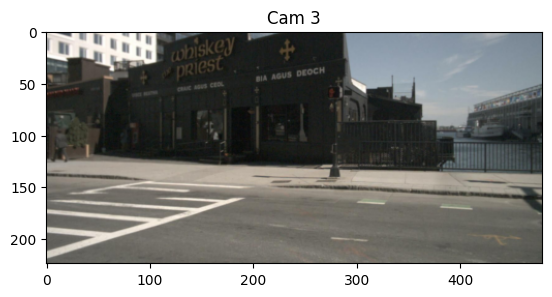

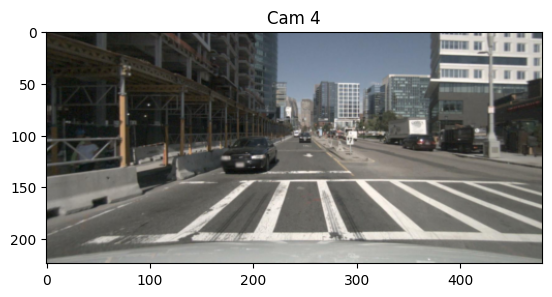

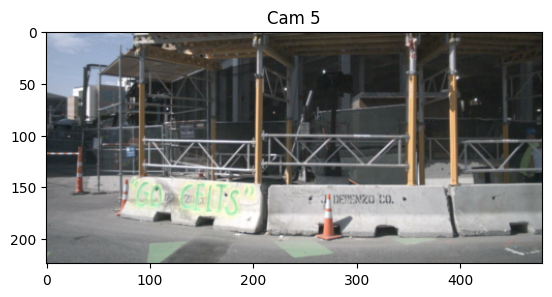

(6, 14, 30)


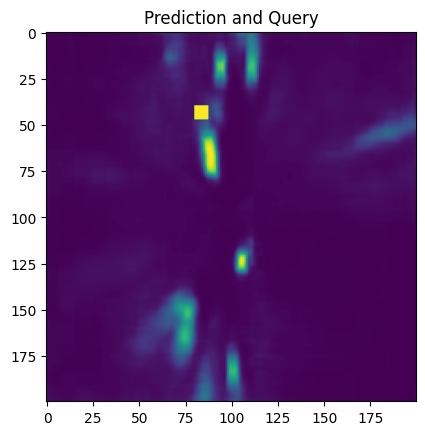

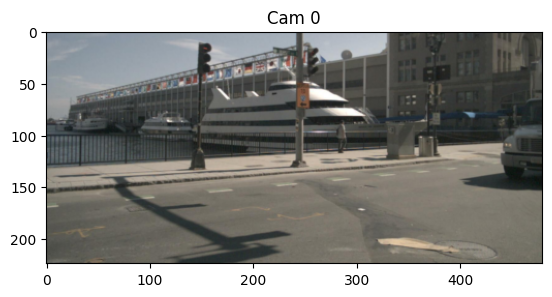

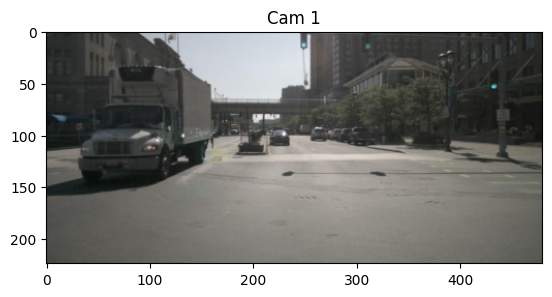

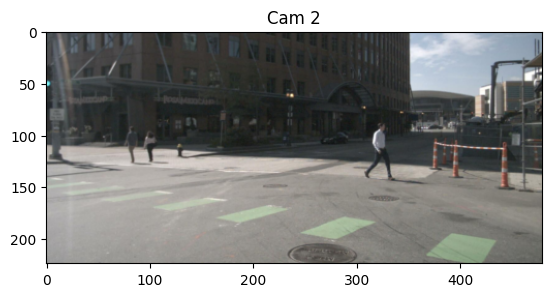

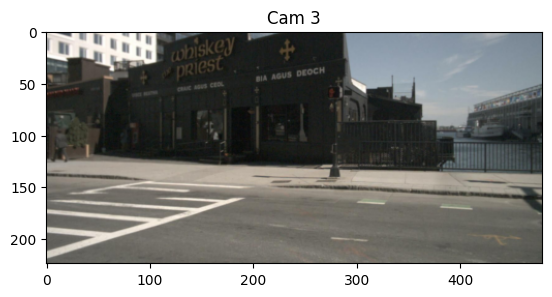

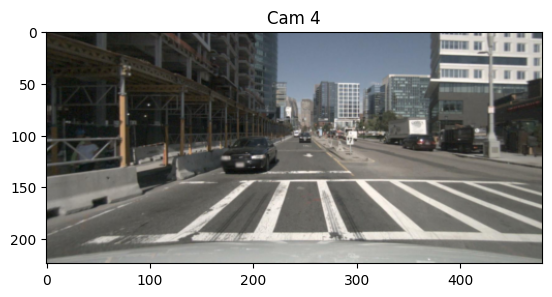

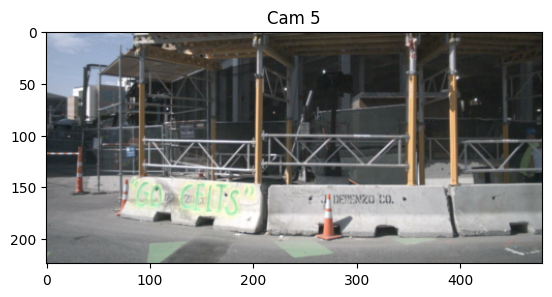

(6, 14, 30)


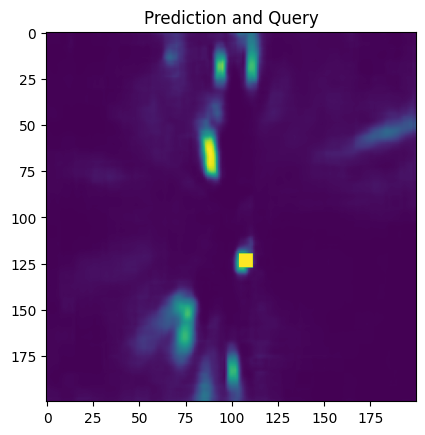

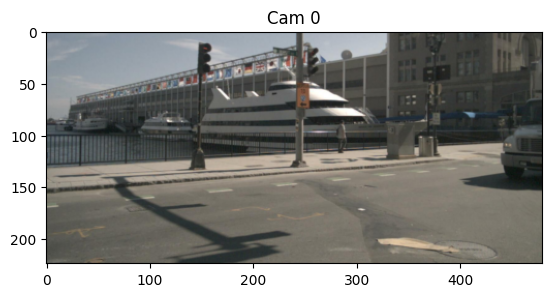

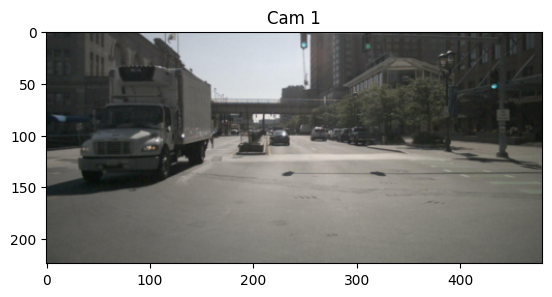

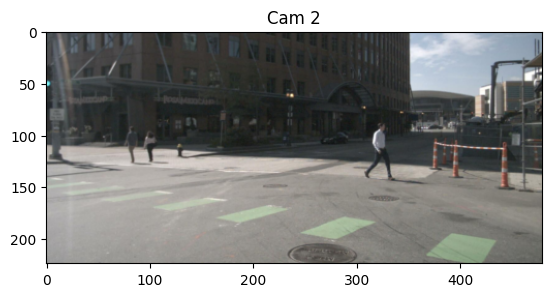

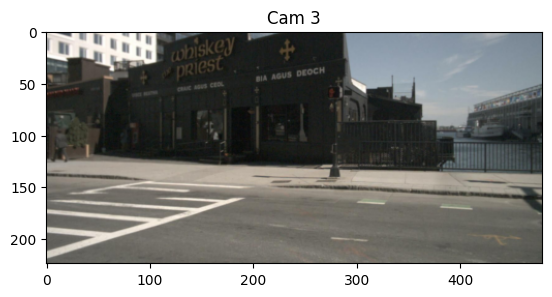

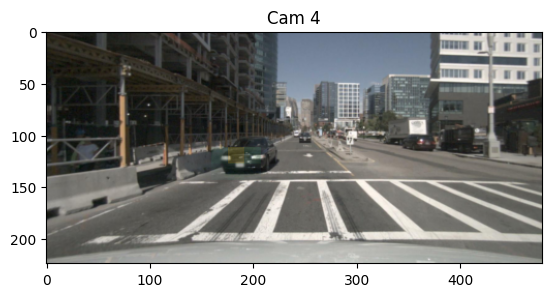

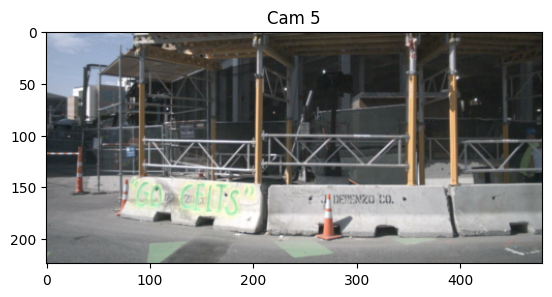

['cam_idx', 'image', 'intrinsics', 'extrinsics', 'bev', 'view', 'visibility', 'center', 'pose']
(6, 14, 30)


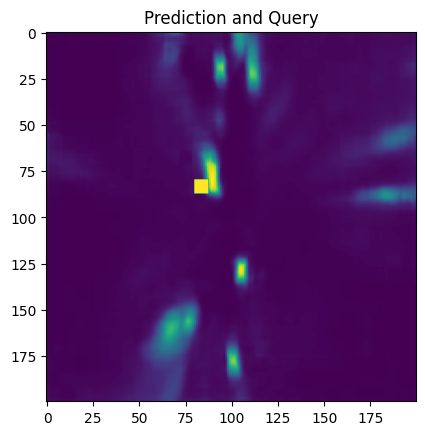

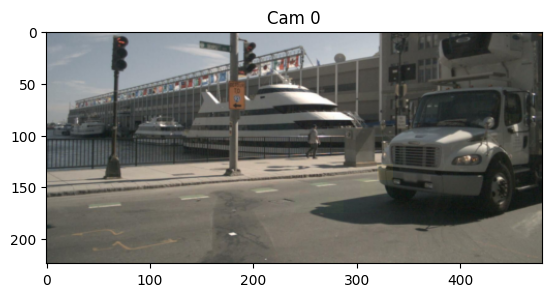

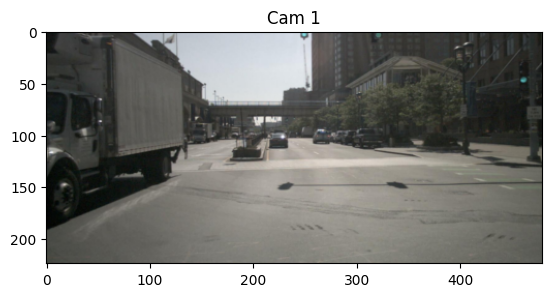

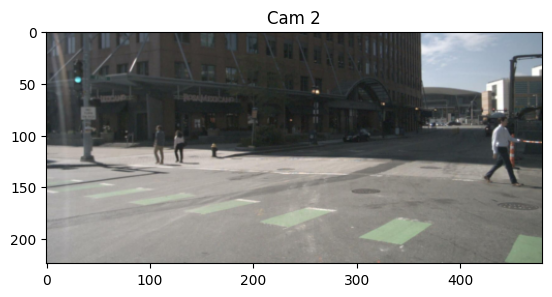

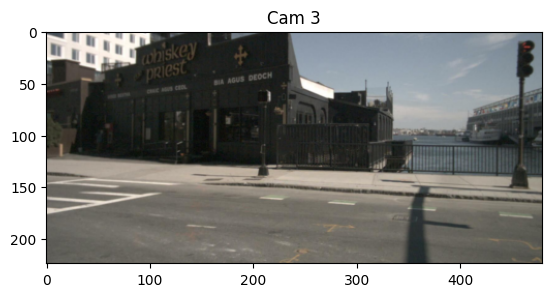

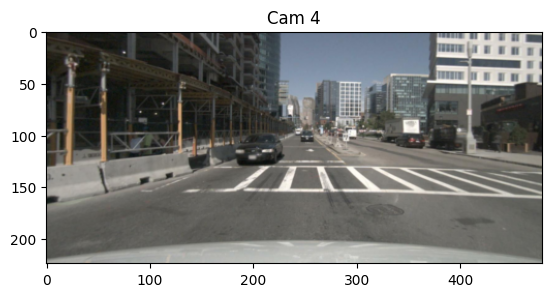

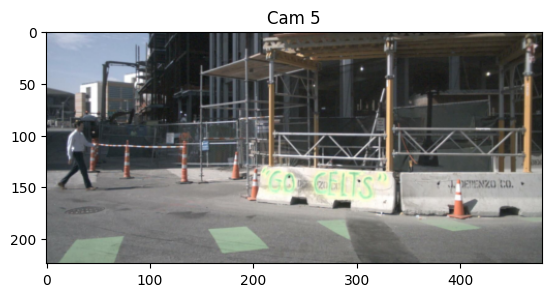

(6, 14, 30)


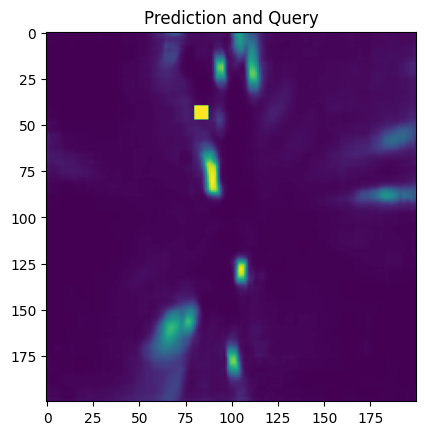

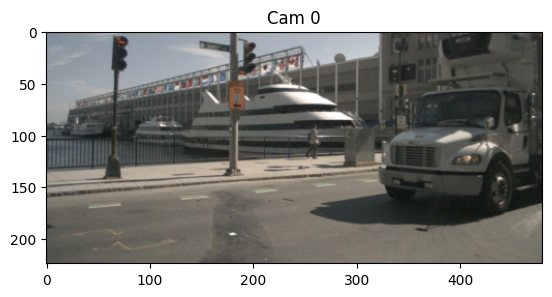

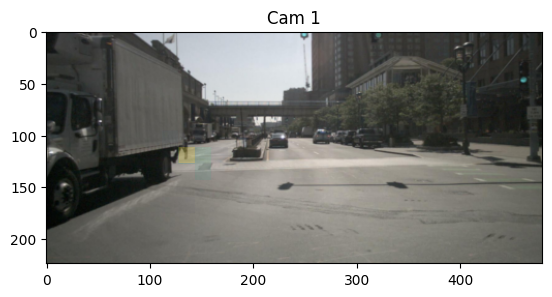

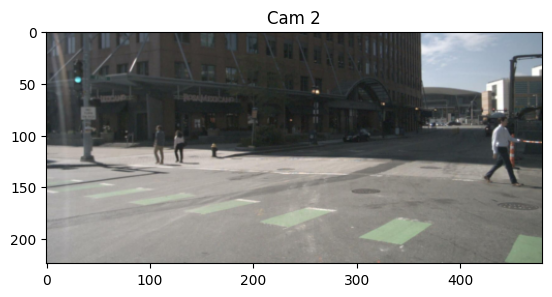

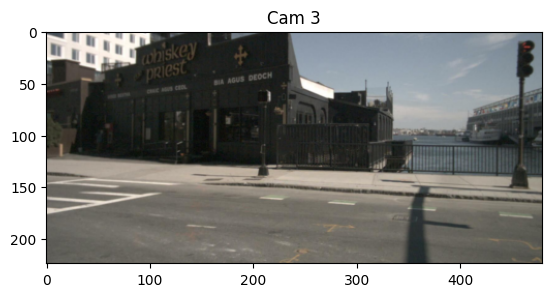

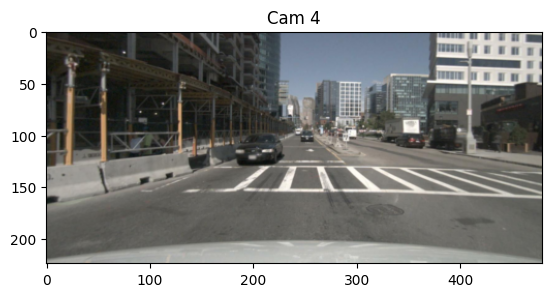

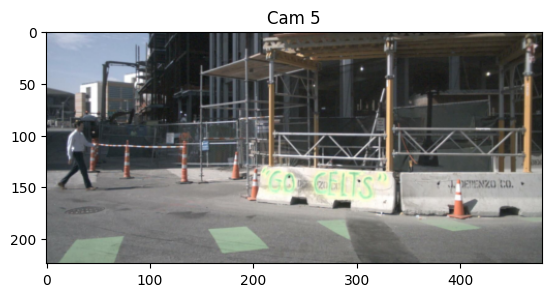

(6, 14, 30)


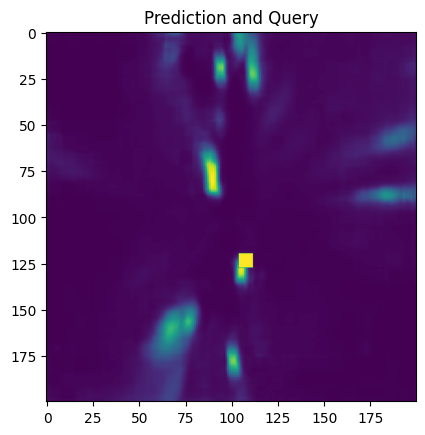

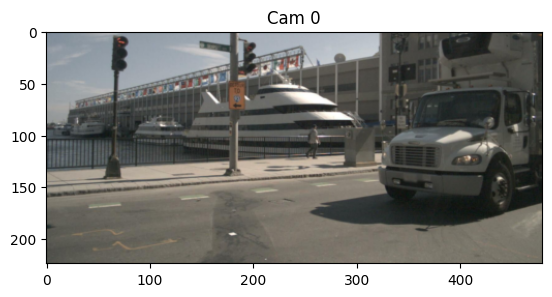

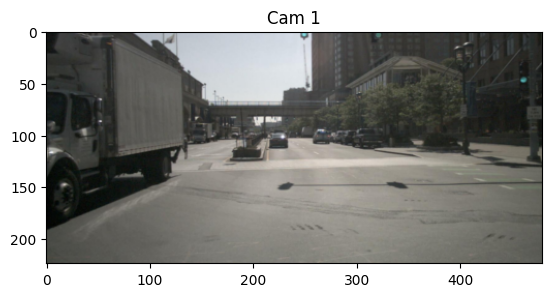

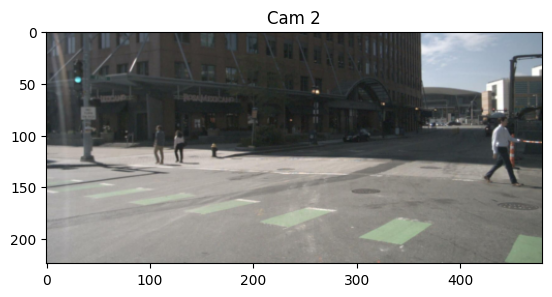

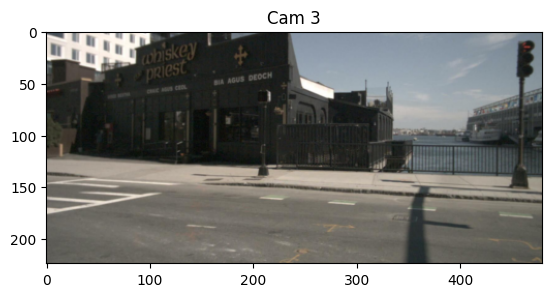

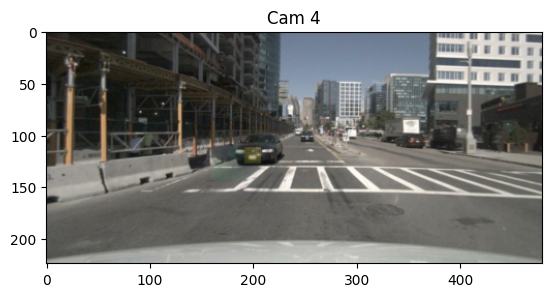

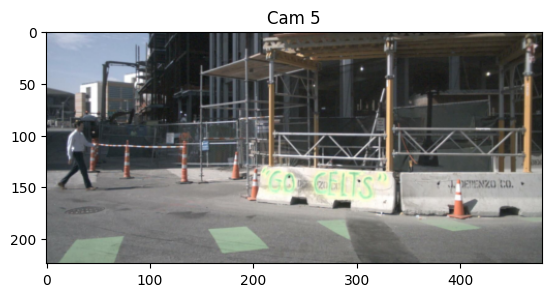

['cam_idx', 'image', 'intrinsics', 'extrinsics', 'bev', 'view', 'visibility', 'center', 'pose']
(6, 14, 30)


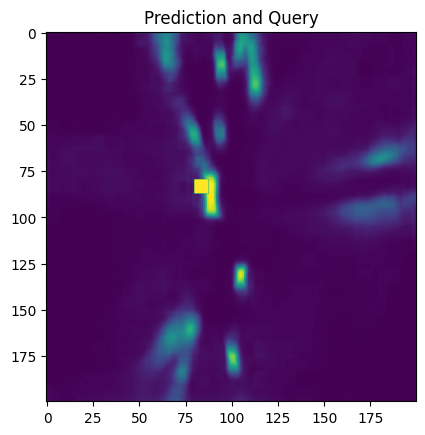

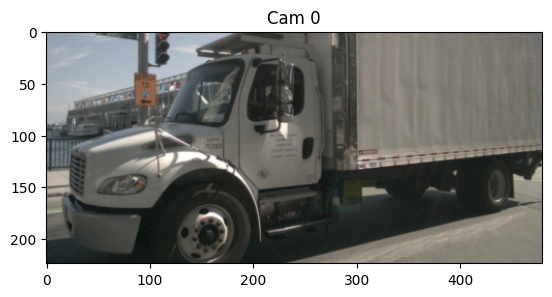

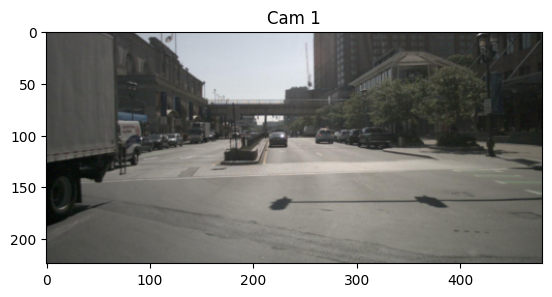

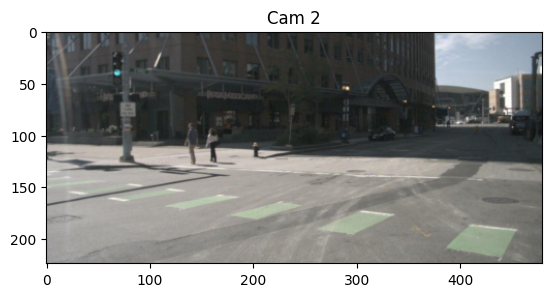

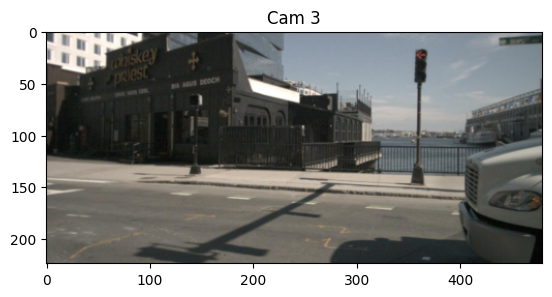

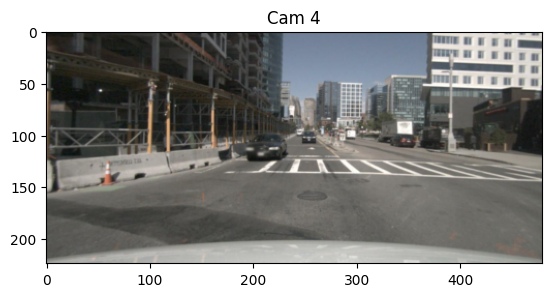

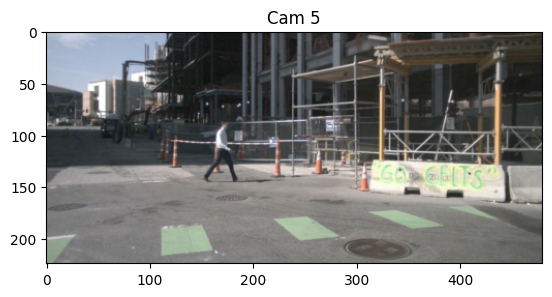

(6, 14, 30)


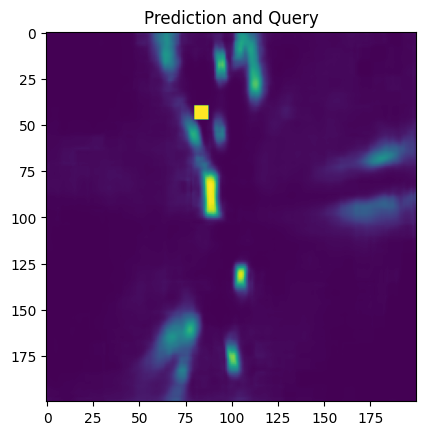

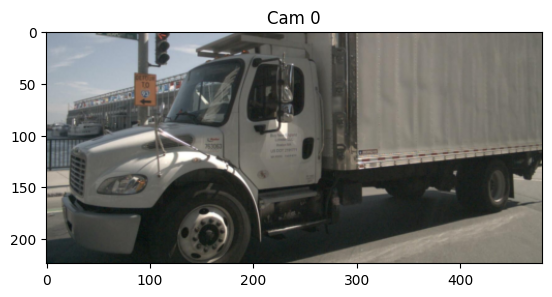

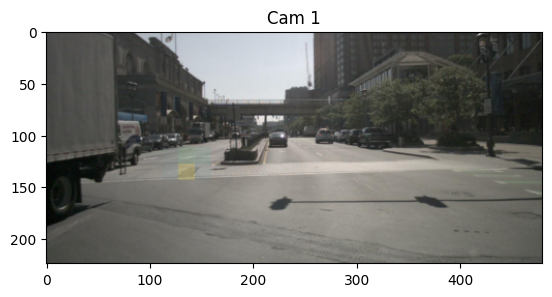

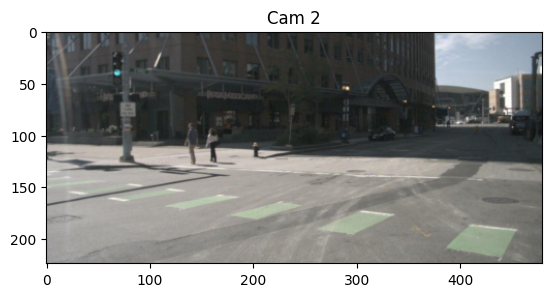

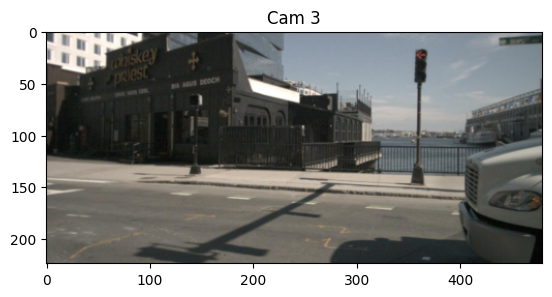

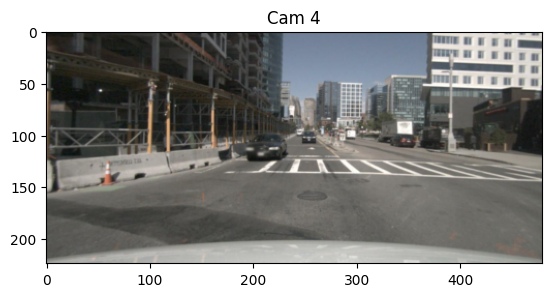

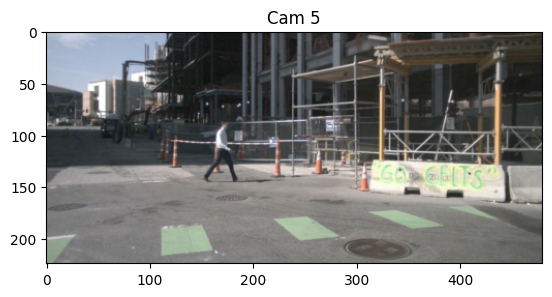

(6, 14, 30)


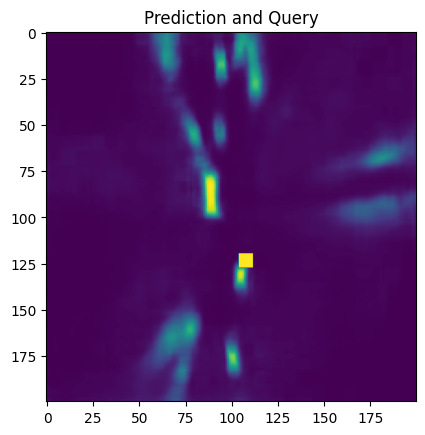

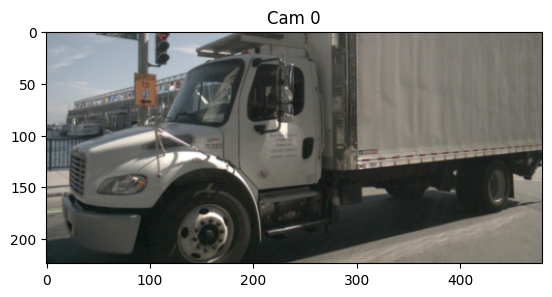

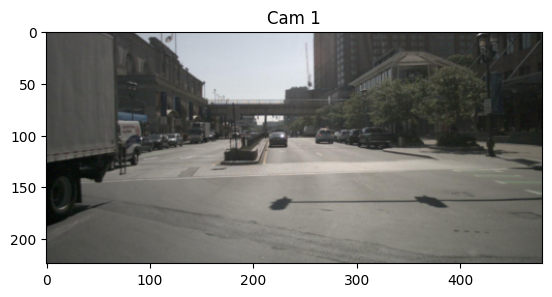

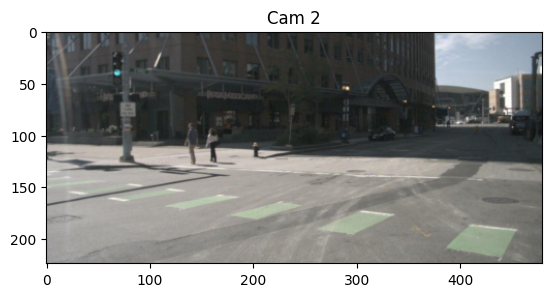

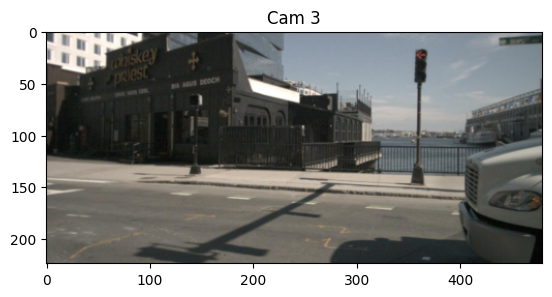

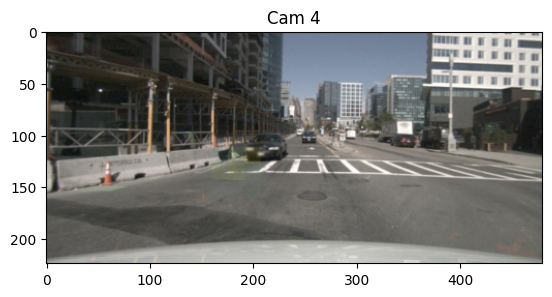

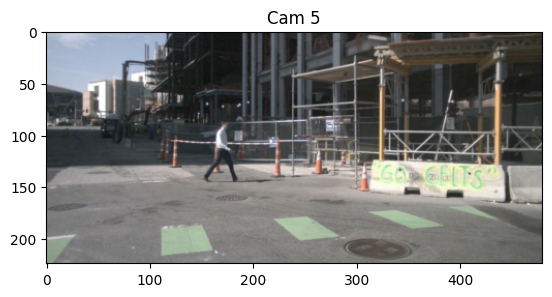

In [48]:
import torch
import time
import matplotlib.pyplot as plt
import ipywidgets as widgets
from einops import rearrange
import cv2

GIF_PATH = './predictions.gif'


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

network.to(device)
network.eval()

H, W = 25, 25
hw = [
    (56, 120),
    (14, 30),
]

query_locations = [
    (10, 10),
    (5, 10),
    (15, 13),
] # (Y, X)

with torch.no_grad():
    for batch in loader:
        batch = {k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in batch.items()}
        print(list(batch.keys()))
        pred, atts = network(batch, return_att=True)

        rearranged_atts = []
        for i, att in enumerate(atts):
            rearrangd_att = rearrange(att, '(b m) (H W) (n h w) -> b m H W n h w', n=6, m=4, H=H, W=W, h=hw[i][0], w=hw[i][1])
            # b: batch n: num_camera, m: attention head number, H: downsampled bev height, W: downsampled bev width, h: downsampled camera height, w: downsampled camera weight
            rearranged_atts.append(rearrangd_att)

        # Visualization
        att = rearranged_atts[-1] # get the last attention layer

        att = att[0] # batch size is 1, we remove the batch dim here.
        mean_att = torch.mean(att, dim=0)

        # Visualize for several different query locations
        for query_location in query_locations:
            att_map = mean_att[query_location[0]][query_location[1]].cpu().numpy()
            print(att_map.shape)

            pred_img = pred['bev'][0][0].sigmoid().cpu().numpy()
            plt.title('Prediction and Query')
            plt.imshow(pred_img)
            # Query mask
            query_mask = np.zeros((H, W))
            query_mask[query_location[0], query_location[1]] = 1
            query_mask = cv2.resize(query_mask, dsize=(pred_img.shape[1], pred_img.shape[0]), interpolation=cv2.INTER_NEAREST)
            plt.imshow(query_mask, alpha=query_mask)
            plt.show()
            for j in range(6):
                cam_img = np.transpose(batch['image'][0][j].cpu().numpy(), (1, 2, 0))
                att_map = mean_att[query_location[0]][query_location[1]][j].cpu().numpy()
                plt.title(f'Cam {j}')
                plt.imshow(cam_img)
                att_map_upsampled = cv2.resize(att_map, dsize=(cam_img.shape[1], cam_img.shape[0]), interpolation=cv2.INTER_NEAREST)
                plt.imshow(att_map_upsampled, alpha=att_map_upsampled)
                plt.show()
